# Visualizing High-Resolution Grids

### In this tutorial, you'll learn about:

* Techniques for visualuzing higher-resolution grids

### Related Documentation 

* [UXarray Plotting User Guide](https://uxarray.readthedocs.io/en/latest/user-guide/plotting.html)

**Time to learn**: 15 minutes

-----

## Introduction

Up to this point in the cookbook, we have only used coarse-resolution unstructured grids.  

In [1]:
import cartopy.crs as ccrs
import uxarray as ux

In [2]:
grid_path = "../../meshfiles/x1.655362.grid.nc"
data_path = "../../meshfiles/x1.655362.data.nc"

uxds = ux.open_dataset(grid_path, data_path)
uxds["relhum_200hPa"]

<xarray.UxDataArray 'relhum_200hPa' (Time: 1, n_face: 655362)> Size: 3MB
[655362 values with dtype=float32]
Dimensions without coordinates: Time, n_face
Attributes:
    units:      percent
    long_name:  Relative humidity vertically interpolated to 200 hPa

## Polygons

As was mentioned in the [Data Visualization](data-viz) notebook, it is suggested to keep `rasterize=True` for higher-resolution grids, especially at a global scales. 


In [3]:
%%time
uxds["relhum_200hPa"][0].plot.polygons(rasterize=True)

CPU times: user 2.81 s, sys: 290 ms, total: 3.1 s
Wall time: 3.12 s


:Image   [x,y]   (x_y relhum_200hPa)

The initial execution time for polygon plotting routines will always be significantly longer since each face is converted to a Polygon and stored as a `GeoDataFrame`. Once this initial processing is done, the geometries can be re-used. Any subsequent polygon plots will render significantly faster.


In [4]:
%%time
res = uxds["relhum_200hPa"][0].plot.polygons(rasterize=True)

CPU times: user 310 ms, sys: 16.5 ms, total: 326 ms
Wall time: 343 ms


It is often a good idea to pair polygon plotting with the subset functionality, especially if you are only interested in visualuzing a specific region. Subsetting will reduce the total number of polygons that are required to be render.

In [5]:
relhum_subset = uxds["relhum_200hPa"][0].subset.bounding_box(
    lon_bounds=[-5, 5], lat_bounds=[-2.5, 2.5]
)
relhum_subset.plot.polygons(rasterize=True)

:Image   [x,y]   (x_y relhum_200hPa)

## Points





At higher resolutions,

In [6]:
%%time
uxds["relhum_200hPa"][0].plot.points(rasterize=True)

CPU times: user 15.4 ms, sys: 3.33 ms, total: 18.7 ms
Wall time: 17.7 ms


:DynamicMap   []
   :Image   [lon,lat]   (lon_lat z)

In [7]:
%%time
uxds["relhum_200hPa"][0].plot.points(rasterize=True, projection=ccrs.Orthographic())

CPU times: user 18.1 ms, sys: 2.48 ms, total: 20.6 ms
Wall time: 19.9 ms


:DynamicMap   []
   :Image   [lon,lat]   (lon_lat z)

:Image   [lon,lat]   (lon_lat z)
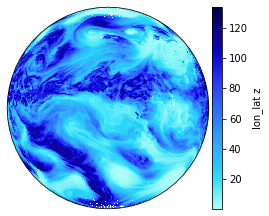

In [35]:
uxds["relhum_200hPa"][0].plot.points(
    rasterize=True, projection=ccrs.Orthographic(), pixel_ratio=1.5, dynamic=False
)

## Discussion